# MS COCO 데이터세트에서 입력한 카테고리 이미지 추출

#### Reference : cocodataset/cocoapi 공식 깃허브 중 pythonAPI Demo
https://github.com/cocodataset/cocoapi/blob/master/PythonAPI/pycocoDemo.ipynb

1. 필요한 라이브러리 import

In [1]:
%matplotlib inline
from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import os
import urllib.request

2. MS_COCO 공식 홈페이지에서 다운로드 받은 JSON 파일이 저장된 공간 설정 및 annFile 변수에 로딩

In [2]:
# 데이터가 저장되어 있는 폴더 C:\MS_COCO_2017
dataDir='/MS_COCO_2017'
# MS COCO 파일명에 의해 어떤 파일을 불러올지 구분 : 예) val2017, train2017, val2014 등
dataType='val2017'
#dataType='train2017'
# 위 정보를 바탕으로 어노테이션 파일경로를 annFile에 생성
annFile='{}/annotations/instances_{}.json'.format(dataDir,dataType)

3. COCO API가 초기화 되었는지 확인

In [3]:
# COCO API 초기화 : 위에서 생성한 annFile은 json 파일 경로를 저장하고 있음
coco=COCO(annFile)
# 초기화가 되면, 메모리에 로딩한 시간과 index가 생성되었다는 문구 출력

loading annotations into memory...
Done (t=0.55s)
creating index...
index created!


4. 불러온 COCO의 카테고리 확인

In [4]:
# MS COCO 데이터세트의 어노테이션은 슈퍼카테고리와 하위카테고리로 구성되어 있는데,
# 데이터세트가 잘 불러왔는지 확인을 위해, 슈퍼카테고리와 하위카테고리 출력 해 보기
cats = coco.loadCats(coco.getCatIds())
nms=[cat['name'] for cat in cats]
print('COCO categories: \n{}\n'.format(' '.join(nms)))
print("하위 카테고리 수 : ", len(nms))

nms = set([cat['supercategory'] for cat in cats])
print('\n\nCOCO supercategories: \n{}'.format(' '.join(nms)))
print("\n슈퍼 카테고리 수 : ", len(nms))
# 출력결과 : 하위카테고리는 80가지, 슈퍼 카테고리는 12가지

COCO categories: 
person bicycle car motorcycle airplane bus train truck boat traffic light fire hydrant stop sign parking meter bench bird cat dog horse sheep cow elephant bear zebra giraffe backpack umbrella handbag tie suitcase frisbee skis snowboard sports ball kite baseball bat baseball glove skateboard surfboard tennis racket bottle wine glass cup fork knife spoon bowl banana apple sandwich orange broccoli carrot hot dog pizza donut cake chair couch potted plant bed dining table toilet tv laptop mouse remote keyboard cell phone microwave oven toaster sink refrigerator book clock vase scissors teddy bear hair drier toothbrush

하위 카테고리 수 :  80


COCO supercategories: 
furniture indoor person animal kitchen accessory appliance electronic outdoor vehicle food sports

슈퍼 카테고리 수 :  12


불러올 사물의 카테고리 ID :  [90]
해당 카테고리를 포함하고 있는 이미지 ID 리스:  [324614, 544519, 293390, 482319, 175251, 160666, 465179, 241319, 445999, 92091, 569917, 521405, 193348, 580294, 218439, 365385, 492878, 284623, 507473, 563281, 368212, 500565, 123480, 327769, 560474, 311394, 55528, 578922, 309484, 229358, 413552, 500464, 164602, 372349]
총 이미지 ID 수 :  34
Save_dir이 생성되었습니다.
C:/MS_COCO/toothbrush_val2017에 파일을 저장합니다.
저장할 데이터는 총 34개입니다.
1번째 데이터 저장완료 - 전체 35
2번째 데이터 저장완료 - 전체 35
3번째 데이터 저장완료 - 전체 35
4번째 데이터 저장완료 - 전체 35
5번째 데이터 저장완료 - 전체 35
6번째 데이터 저장완료 - 전체 35
7번째 데이터 저장완료 - 전체 35
8번째 데이터 저장완료 - 전체 35
9번째 데이터 저장완료 - 전체 35
10번째 데이터 저장완료 - 전체 35
11번째 데이터 저장완료 - 전체 35
12번째 데이터 저장완료 - 전체 35
13번째 데이터 저장완료 - 전체 35
14번째 데이터 저장완료 - 전체 35
15번째 데이터 저장완료 - 전체 35
16번째 데이터 저장완료 - 전체 35
17번째 데이터 저장완료 - 전체 35
18번째 데이터 저장완료 - 전체 35
19번째 데이터 저장완료 - 전체 35
20번째 데이터 저장완료 - 전체 35


<ipython-input-5-c8cf00694856>:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize = (20, 20))


21번째 데이터 저장완료 - 전체 35
22번째 데이터 저장완료 - 전체 35
23번째 데이터 저장완료 - 전체 35
24번째 데이터 저장완료 - 전체 35
25번째 데이터 저장완료 - 전체 35
26번째 데이터 저장완료 - 전체 35
27번째 데이터 저장완료 - 전체 35
28번째 데이터 저장완료 - 전체 35
29번째 데이터 저장완료 - 전체 35
30번째 데이터 저장완료 - 전체 35
31번째 데이터 저장완료 - 전체 35
32번째 데이터 저장완료 - 전체 35
33번째 데이터 저장완료 - 전체 35
34번째 데이터 저장완료 - 전체 35


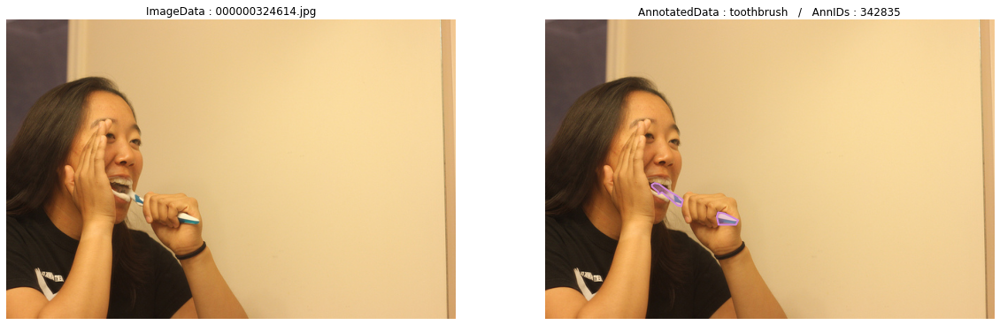

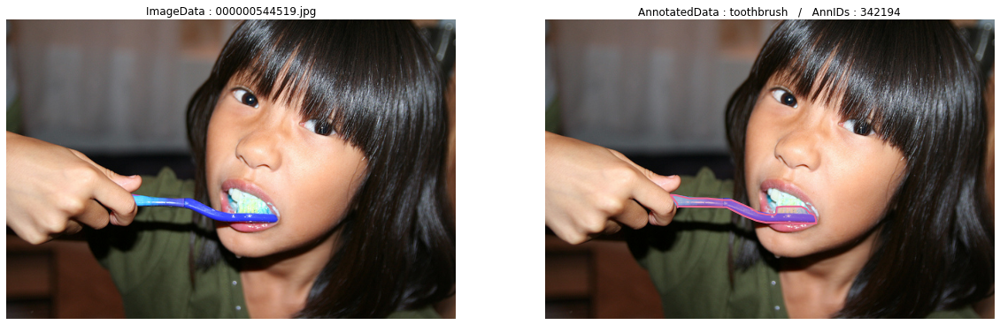

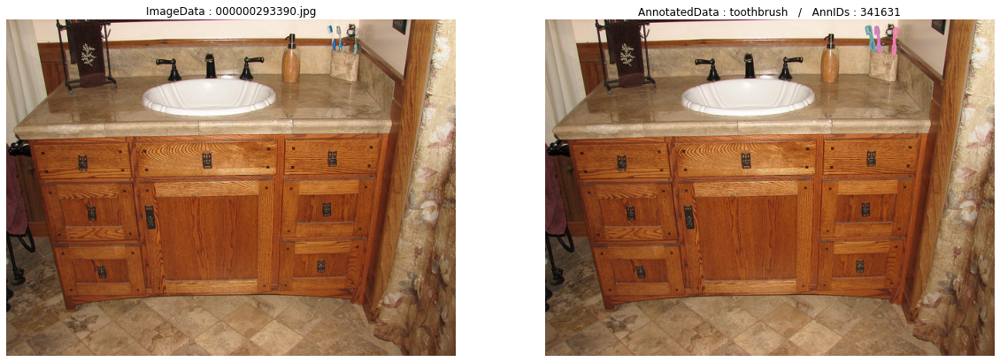

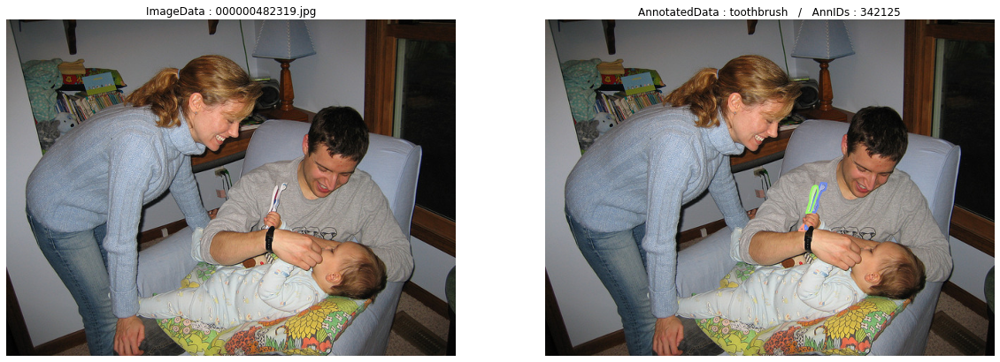

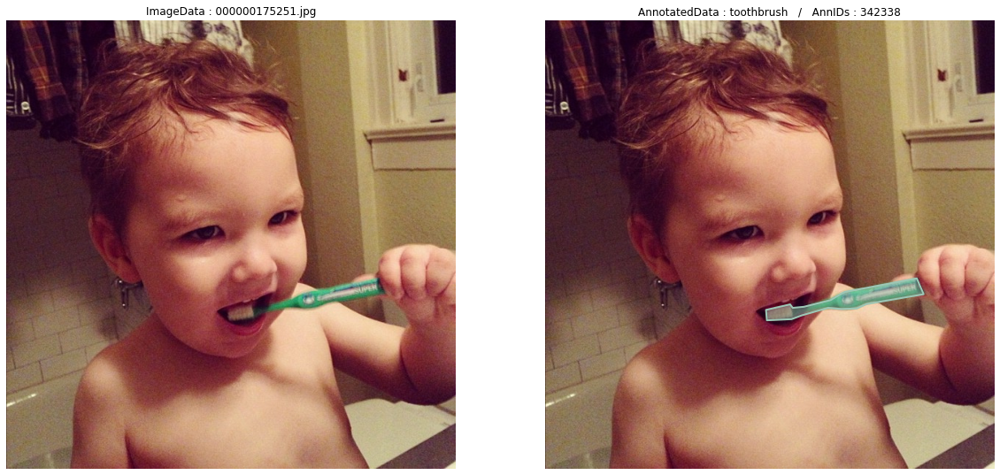

...

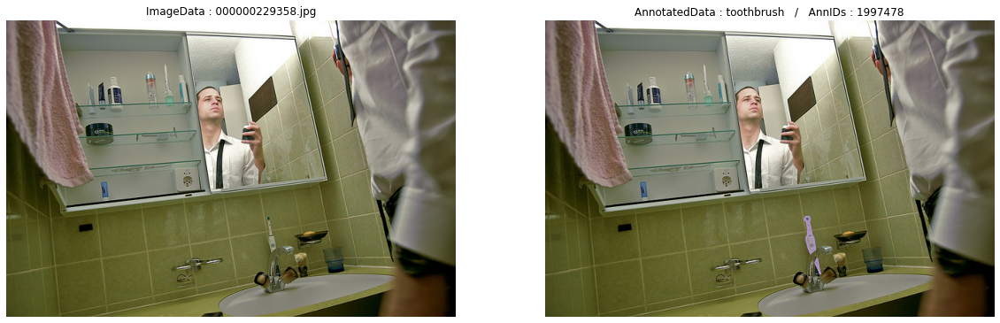

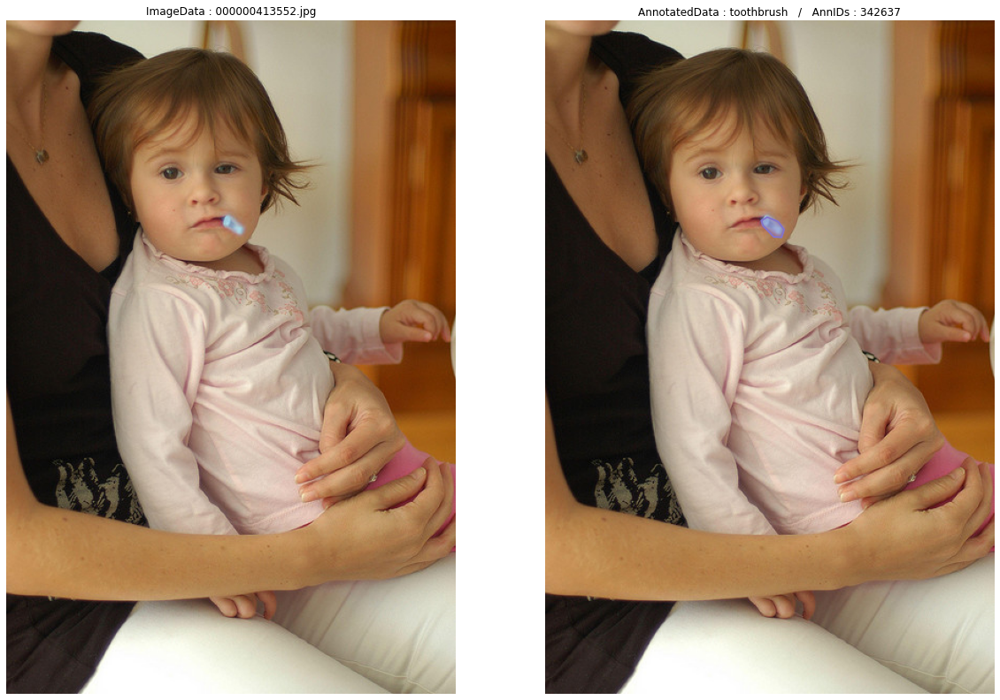

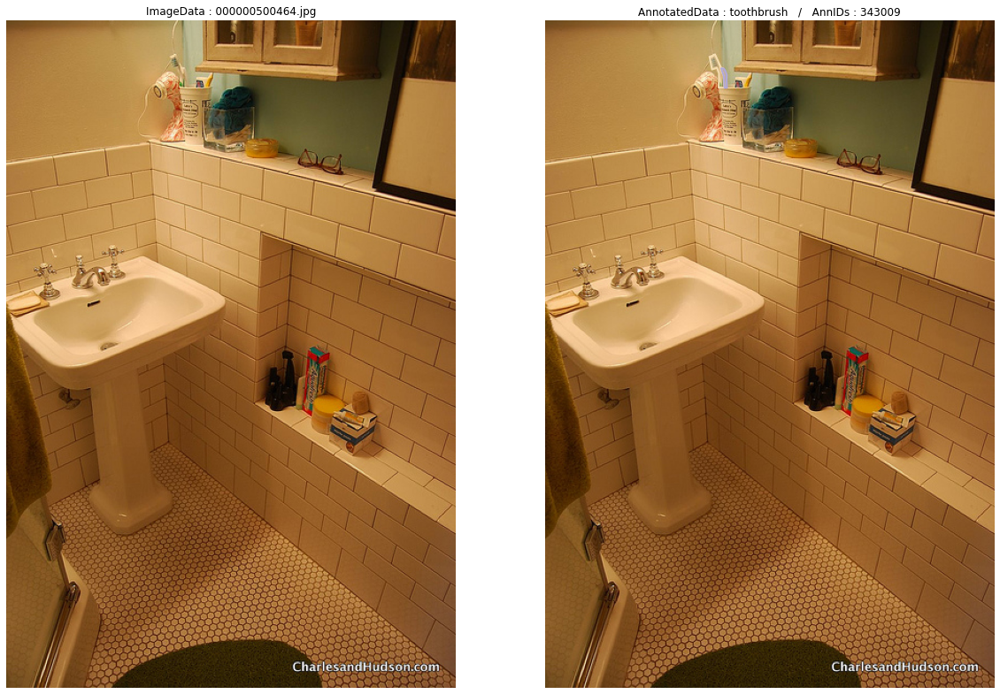

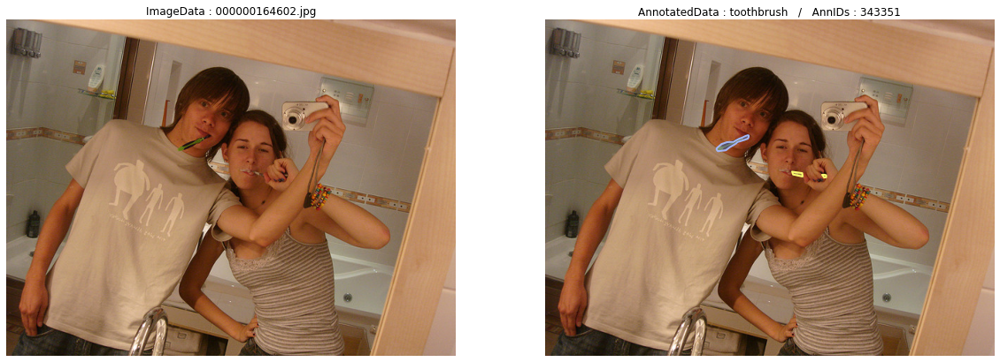

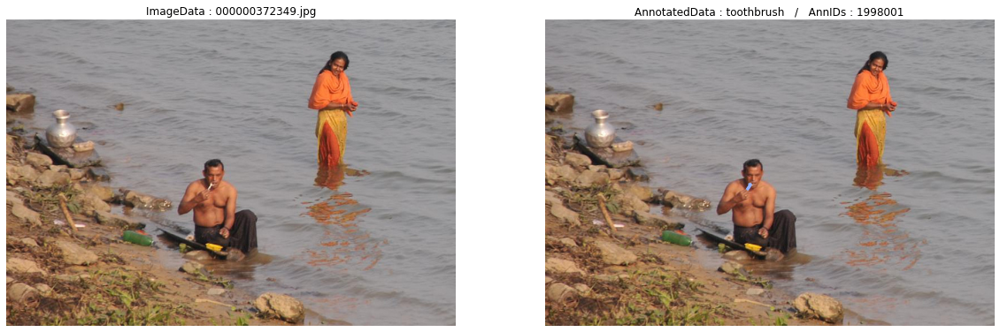

In [5]:
className = 'toothbrush'
# 입력한 카테고리의 ID를 catIds에 저장 : 예) fork는 ID가 48
#catIds = coco.getCatIds(catNms=['cup','fork','knife']);
#catIds = coco.getCatIds(catNms=['fork']);
# 위 주석과 같이 cup, fork, knife가 모두 있는 사진을 불러오거나, fork만 있는 사진을 불러올 수 있음
catIds = coco.getCatIds(catNms=[className]);
print("불러올 사물의 카테고리 ID : ", catIds)

# 카테고리 ID로 가지고 이미지 ID 불러오기
imgIds = coco.getImgIds(catIds=catIds );
print("해당 카테고리를 포함하고 있는 이미지 ID 리스: ", imgIds)
print("총 이미지 ID 수 : ", len(imgIds))

# 아래 주석과 같이 해당 이미지 ID를 직접입력해도 되고,
#imgIds = coco.getImgIds(imgIds = [166426])
# 아래 코드처럼 이미지ID 리스트 중에서 랜덤으로 선택가능
#img = coco.loadImgs(imgIds[np.random.randint(0,len(imgIds))])[0]

base_dir = "C:/MS_COCO"
class_dir = className + "_" + dataType
save_dir = base_dir + "/" + class_dir

if (os.path.isdir(base_dir) == False):
    os.mkdir(base_dir)
    print("Base_dir이 생성되었습니다.")
if (os.path.isdir(save_dir) == False):
    os.mkdir(save_dir)
    print("Save_dir이 생성되었습니다.")

print(save_dir + "에 파일을 저장합니다.")
print("저장할 데이터는 총 {}개입니다.".format(len(imgIds)))

for i in range(0, len(imgIds)):
    img = coco.loadImgs(imgIds[i])[0]
    try:
        I = io.imread(img['coco_url'])
    except:
        print("COCO URL에 문제가 있어서 I를 생성하지 못함")
    
    # coco.loadImgs로 생성된 img는 파일이름과 온라인 URL, 높이, 너비, 날짜, 플리커URL, ID 정보를 가지고 있음
    ###print(img)

    # img의 'id'의 ID값과 카테고리 ID를 이용하여 coco.getAnnIds를 호출하면, 어노테이션 ID가 불러와짐
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    # 불러온 어노테이션 ID를 coco.loadAnns에 변수로 넣어 호출하면, Segmentation 정보를 불러오고,
    anns = coco.loadAnns(annIds)
    ###print(anns)

    fileName = img['file_name']
    imageName = "ImageData : " + fileName
    annotatedName = "AnnotatedData : " + className + "   /   " + "AnnIDs : " + str(annIds[0])

    fig = plt.figure(figsize = (20, 20))
    ax1 = fig.add_subplot(1, 2, 1)
    ax1.set_title(imageName)
    ax1.axis('off')
    try:
        ax1.imshow(I)
    except:
        print("{}번째 이미지로드 에러발생 - URL Missing".format(i+1))

    ax2 = fig.add_subplot(1, 2, 2)
    ax2.set_title(annotatedName)
    ax2.axis('off')
    try:
        ax2.imshow(I)
    except:
         print("{}번째 이미지로드 에러발생 - URL Missing".format(i+1))

    # coco.showAnns를 이용하여 사진에 표시함
    coco.showAnns(anns)

    ###plt.show()

    saveName = save_dir + "/Annotated_" + fileName
    fig.savefig(saveName, bbox_inches='tight')
    print(str(i+1) + "번째 데이터 저장완료 - 전체 " + str(len(imgIds)))
    
    # 데이터세트 원본 이미지파일 저장
    imgURL = img['coco_url']
    fileName = save_dir + "/" + img['file_name']
    try:
        urllib.request.urlretrieve(imgURL, fileName)
    except:
        print("에러발생 - URL Missing : ", imgURL)